In [1]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn import model_selection
import data_handler
import numpy as np
import seaborn as sns
from scipy import stats
# import missingno
path='../../data/raw_do_not_touch'

%load_ext autoreload
%autoreload 2

In [2]:
# Load raw data, since we do not want data that is normalized
seed = 418409376
raw_path = '../../data/raw_do_not_touch'

data = pd.read_csv(raw_path + '/5year.txt')
x = data.iloc[:, :-1].to_numpy()
y = data.iloc[:, -1]

x_train, x_test, y_train, y_test = model_selection.train_test_split(
                x, 
                y, 
                test_size=0.2, 
                random_state=seed, 
                shuffle=True, 
                stratify=y
            )

In [3]:
# Replace outliers with nan
rem_out = data_handler.remove_outliers(2)
rem_out.fit(x_train, y)
x_train = rem_out.transform(x_train)
x_train = pd.DataFrame(x_train)
y_train.reset_index(inplace=True, drop=True)

# Concat to calculate largest correlations
df = pd.concat([x_train, y_train], axis=1, ignore_index=True)

/Users/karl/Documents/01_personlig/04_Koding/GitHub/2021_ml_seminar/code/python/data_handler.py:221: RuntimeWarning: invalid value encountered in greater
  large_val = abs(X_new[:, col]) > std_threshold


In [4]:
# Calculate correlations and get a list of the 5 most important variables
corr_mat = df.corr()
y_corr = corr_mat.iloc[:-1, -1]
important_coeff_arg = np.flip(
        np.argsort(np.abs(y_corr))
    )
coeff_10 = important_coeff_arg.iloc[:5]

# Create frame to pairplot
pairplot = pd.concat([x_train.loc[:, [i for i in coeff_10]], y_train], axis=1)

# Get varnames and add to pairplot
varnames = data_handler.ohlson_varnames()
plot_names = [varnames[i] for i in coeff_10]
plot_names.append('Bankrupt')
pairplot.columns = plot_names

In [7]:
plot_names

['profit on sales / sales',
 'constant capital / total assets',
 '(equity - share capital) / total assets',
 'equity / total assets',
 'total liabilities / total assets',
 'Bankrupt']

In [8]:
# Manual cleaning of a single, strange outlier that isnt caight otherwise.
pairplot = pairplot[pairplot.loc[:, 'constant capital / total assets'] < 4]
pairplot = pairplot[pairplot.loc[:, '(equity - share capital) / total assets'] > -6]

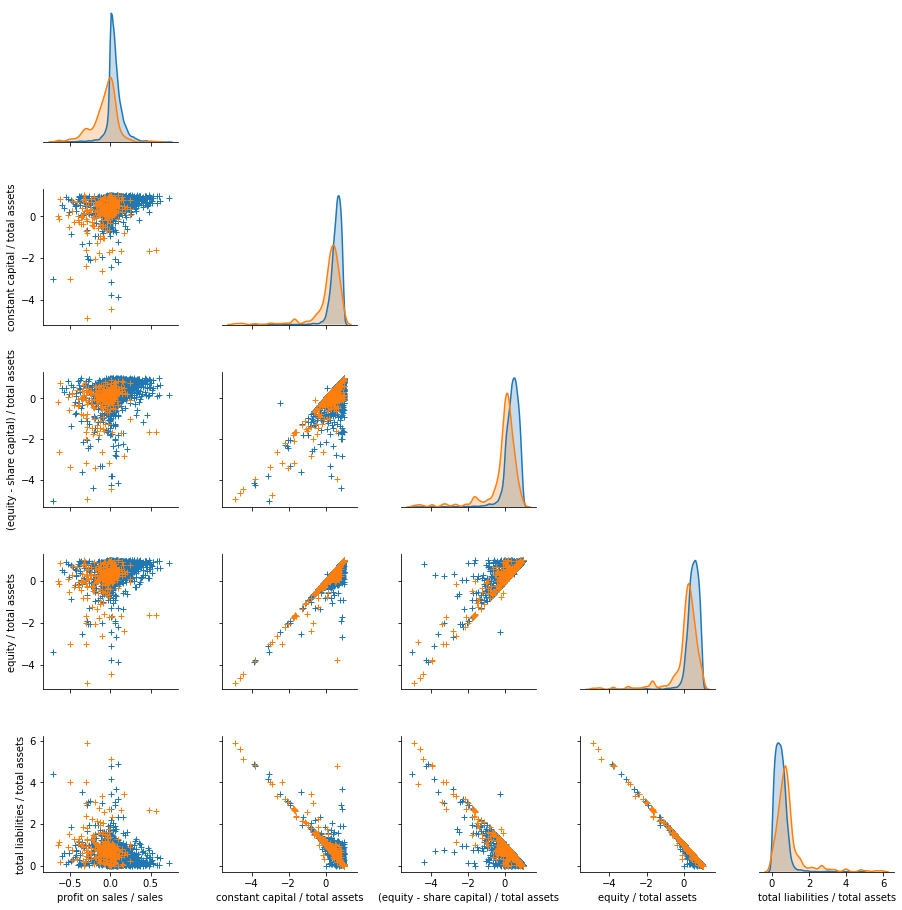

In [11]:
# Plot pairplot of 5 most important vars.
graph = sns.pairplot(pairplot, hue='Bankrupt', plot_kws=dict(marker='+', linewidth=1), corner=True)
graph._legend.remove()
graph.savefig("pairplot.png")

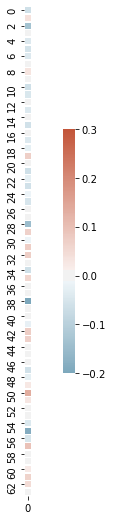

In [34]:
corr = df.corr()
corr = corr.iloc[:-1, -1]
corr = np.array(corr)
corr = corr.reshape(-1, 1)

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

In [ ]:
# for inspection
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', -1)

# Correlation plots
- X1 net profit / total assets
- X2 total liabilities / total assets
- X3 working capital / total assets
- X21 sales (n) / sales (n-1)
- X29 logarithm of total assets

In [73]:
Y = ['Y']

There is definitely some outliers here!! 
We could remove some of the biggest outliers

In [74]:
# doesn't work properly atm

pairplot_dfs = [df[['X1','X2','X3','X21','X29','Y']] for df in dfs]

ys = [pd.DataFrame(df.iloc[:,-1]) for df in pairplot_dfs]
pairplot_dfs = [df.iloc[:,:-1] for df in pairplot_dfs]

# test

pairplot_dfs[0] = pairplot_dfs[0].loc[(np.abs(stats.zscore(pairplot_dfs[0])) < threshold)]
pairplot_dfs[0]

# removing outliers 

#threshold = 3 # number of standard deviations from mean 
#outlier_free_dfs = [df.loc[(np.abs(stats.zscore(df)) < threshold)] for df in pairplot_dfs]   # not on y column somehow
#outlier_free_dfs = [outlier_free_dfs[i].merge(ys[i],how="left") for i in range(len(outlier_free_dfs))]
#outlier_free_dfs[0]

,X1,X2,X3,X21,X29


In [ ]:
#for i in range(len(dfs)):
sns.pairplot(outlier_free_dfs[0],hue='Y')

Alternatively...

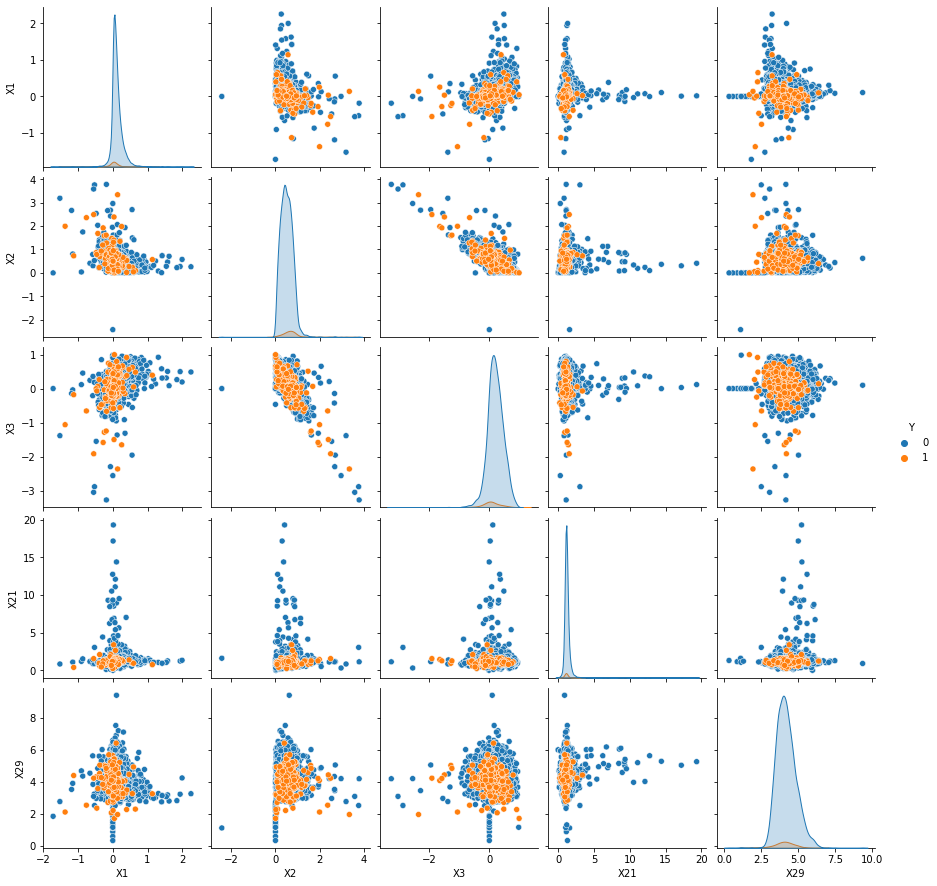

In [36]:
sns.pairplot(pairplot_dfs[0].loc[
    ~(np.abs(pairplot_dfs[0]['X1'])>20) &
    ~(np.abs(pairplot_dfs[0]['X2'])>20)& 
    ~(np.abs(pairplot_dfs[0]['X3'])>8)&    
    ~(np.abs(pairplot_dfs[0]['X21'])>20)],
    hue='Y')


In terms of the distributions, the imbalance is quite clear

# Class imbalance, too few bankruptcy cases?

In [ ]:
missing_dfs = [df[df.isna().any(axis=1)] for df in dfs]

In [ ]:
for i in range(len(dfs)):
    assert len(dfs) == len(clean_dfs)
    bankrupt_share = (dfs[i]['Y'].tolist().count(1) / len(dfs[i]['Y'].tolist()))*100
    bankrupt_clean_share = (clean_dfs[i]['Y'].tolist().count(1) / len(clean_dfs[i]['Y'].tolist()))*100
    bankrupt_missing_share = (missing_dfs[i]['Y'].tolist().count(1) / len(missing_dfs[i]['Y'].tolist()))*100
    print(f'Year {i+1}: Share of bankrupt companies in dataset: {bankrupt_share}')
    print(f'Year {i+1}: Share of bankrupt companies in CLEANED dataset: {bankrupt_clean_share}')
    print(f'Year {i+1}: Share of bankrupt companies in MISSING dataset: {bankrupt_missing_share}\n')

    #sns.countplot(x='Y',data=dfs[i])

Most classification algorithms will only perform optimally when the number of samples of each class is roughly the same. Highly skewed datasets, where the minority is heavily outnumbered by one or more classes, have proven to be a challenge while at the same time becoming more and more common.
One way is to re-sample the dataset, in our case we should probably oversample the minority (bankrupt)
https://github.com/scikit-learn-contrib/imbalanced-learn

In [ ]:
missing_dfs[0]